# Analyses of Baby Name Popularity Distribution in U.S. for the Last 144 Years

In [2]:
import numpy as np
import pandas as pd

# plotting
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objs as go
import matplotlib.pyplot as plt

# stats
from statsmodels.api import tsa # time series analysis
import statsmodels.api as sm
from statsmodels.tsa.statespace.sarimax import SARIMAX

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
from datetime import datetime
import plotly
import plotly.express as px


from warnings import filterwarnings
filterwarnings('ignore')


import plotly.express as px
import plotly.offline as pyo
pyo.init_notebook_mode()

### 1.1 Last 144 Years Baby Name Dataset

In [3]:
file_path = '/Users/yingzhou/Downloads/Capstone_Babyname/notebooks/Featured_Data.csv'

# Read the CSV file into a DataFrame
data = pd.read_csv(file_path, index_col=0)

# Display the first few rows to verify
print(data.head())

           Name  Year Gender  Count  Name_Ratio  Gender_Name_Ratio  Is_Famous  \
128731    Aaden  2008      M    958    0.243760           0.469689          0   
129570    Aaden  2009      M   1268    0.331981           0.639458          0   
114438  Aaliyah  1994      F   1451    0.390318           0.812591          0   
115498  Aaliyah  1995      F   1256    0.342980           0.714250          0   
116688  Aaliyah  1996      F    831    0.227856           0.474070          0   

        Gender_Binary  Year_of_Last_Appearance  Is_Top_100  ...  \
128731              1                     2009           0  ...   
129570              1                     2009           0  ...   
114438              0                     2023           0  ...   
115498              0                     2023           0  ...   
116688              0                     2023           0  ...   

        Rolling_Average_Gender_Ratio_5_Years  \
128731                              0.469689   
129570        

In [4]:
data.shape

(144042, 21)

In [5]:
data_num= data.select_dtypes('number')

In [6]:
data_num.shape

(144042, 19)

## Part 2 - Cluster Modelling

### Part 2.2 All Data Cluster Model

In [7]:
from sklearn.model_selection import train_test_split

X = data_num.drop(columns=['Is_Top_100'])   
y = data_num['Is_Top_100']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [8]:
from sklearn.preprocessing import StandardScaler, PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

# Define column groups
binary_features = ['Is_Famous', 'Gender_Binary']
continuous_features = [
    'Year', 'Count', 'Name_Ratio', 'Gender_Name_Ratio', 'Year_of_Last_Appearance',
    'Rolling_Average_Count_5_Years', 'Rolling_Average_Gender_Ratio_5_Years',
    'Rolling_Average_National_Ratio_5_Years', 'Yearly_Change_Count',
    'Yearly_Change_Gender_Ratio', 'Yearly_Change_National_Ratio', 'Name_Length',
    'Vowel_Count', 'Consonant_Count', 'Vowel_Ratio', 'Ends_With_Specified_Letters'
]

# Create preprocessing transformers
preprocessor = ColumnTransformer(
    transformers=[
        ('binary', 'passthrough', binary_features),   
        ('continuous', Pipeline([
            ('scaler', StandardScaler())   
         
        ]), continuous_features)
    ]
)

# Initialize and fit the pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor)
])


# Fit and transform the training data
pipeline.fit(X_train)
X_train_transformed = pipeline.transform(X_train)
X_test_transformed = pipeline.transform(X_test)

# Get feature names after transformation
# For continuous features
continuous_feature_names = pipeline.named_steps['preprocessor'].transformers_[1][1].named_steps['scaler'].get_feature_names_out()
# For binary features, they remain the same
binary_feature_names = binary_features

# Combine feature names
feature_names = list(binary_feature_names) + list(continuous_feature_names)

# Create DataFrames for transformed data
df_train_scaled = pd.DataFrame(X_train_transformed, columns=feature_names, index=X_train.index)
df_test_scaled = pd.DataFrame(X_test_transformed, columns=feature_names, index=X_test.index)


In [9]:
from sklearn.cluster import KMeans
# Initialize KMeans
kmeans = KMeans(n_clusters=2, random_state=42)

# Fit KMeans to the scaled training data
kmeans.fit(df_train_scaled)

# Predict cluster labels
kmeans_labels = kmeans.predict(df_train_scaled)

# Add cluster labels to the DataFrame
df_train_scaled['kmeans_label'] = kmeans_labels

# Print the DataFrame with cluster labels
print(df_train_scaled)


        Is_Famous  Gender_Binary      Year     Count  Name_Ratio  \
130356        1.0            1.0  1.405378  0.010007   -0.134663   
80780         1.0            1.0  0.203030 -0.309667   -0.368044   
124463        1.0            0.0  1.261096 -0.101151   -0.220236   
124980        0.0            1.0  1.261096 -0.300085   -0.355841   
105364        1.0            0.0  0.804204 -0.092143   -0.198656   
...           ...            ...       ...       ...         ...   
1189          1.0            0.0 -1.696681 -0.380962    0.004721   
100247        1.0            0.0  0.683969  0.124615   -0.026295   
90513         1.0            0.0  0.443499 -0.192760   -0.273754   
111494        1.0            0.0  0.948486 -0.171487   -0.271332   
88797         1.0            0.0  0.395405 -0.317334   -0.359030   

        Gender_Name_Ratio  Year_of_Last_Appearance  \
130356          -0.143109                 0.807740   
80780           -0.364048                -0.785790   
124463          -0.20

In [10]:
from sklearn.decomposition import PCA

myPCA=PCA(n_components=3)
my_pca_results= myPCA.fit_transform(df_train_scaled.drop(columns='kmeans_label'))



In [11]:
type(my_pca_results)

numpy.ndarray

In [12]:
my_pca_results.shape

(115233, 3)

In [13]:
pca_df = pd.DataFrame(my_pca_results, index = df_train_scaled.index, columns=[f'PC{i+1}'for i in range(3)])
pca_df.head()

,PC1,PC2,PC3
130356,-0.216822,0.033327,0.019218
80780,-0.926553,-0.320717,0.116429
124463,-0.067384,1.040299,-1.821265
124980,-1.040146,-1.246249,1.806323
105364,-0.382946,-0.229498,0.497243


In [14]:
np,sum(myPCA.explained_variance_ratio_) 

(<module 'numpy' from '/Users/yingzhou/anaconda3/envs/ml_env/lib/python3.8/site-packages/numpy/__init__.py'>,
 0.6526180595237222)

In [15]:
from sklearn.metrics import silhouette_score

# Drop the 'kmeans_label' column for evaluation
features = df_train_scaled.drop(columns=['kmeans_label'])

# Compute silhouette score
silhouette_avg = silhouette_score(features, df_train_scaled['kmeans_label'])
print(f'Silhouette Score: {silhouette_avg:.4f}')

Silhouette Score: 0.6653


In [16]:
# Create a DataFrame with PCA results and cluster labels
pca_df = pd.DataFrame(my_pca_results, columns=['PC1', 'PC2', 'PC3'])
pca_df['kmeans_label'] = kmeans_labels

In [17]:
# Visualize the clusters in 3D
fig = px.scatter_3d(pca_df, x='PC1', y='PC2', z='PC3', color='kmeans_label', opacity=0.5)
fig.show()



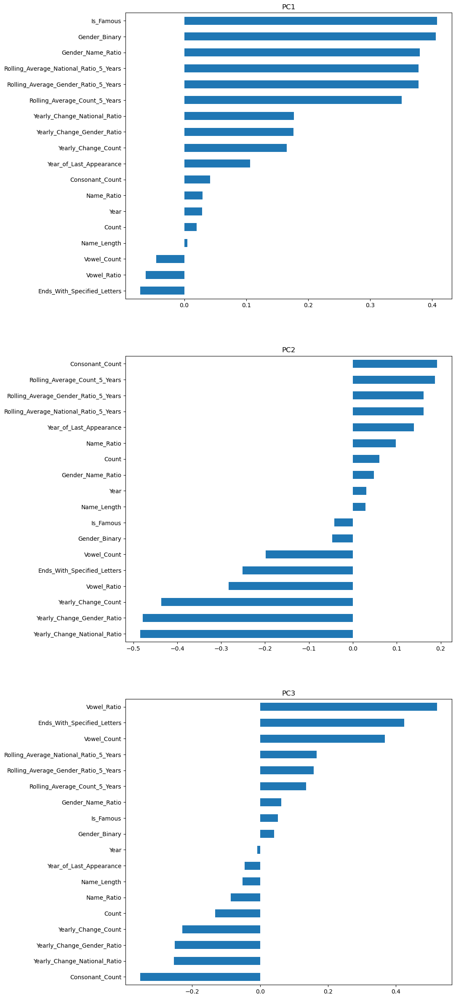

In [18]:
# Plot PCA component loadings
loadingsDF = pd.DataFrame(myPCA.components_.T, columns=['PC1', 'PC2', 'PC3'], index=X.columns)

plt.subplots(3, 1, figsize=(10, 30))

plt.subplot(3, 1, 1)
loadingsDF['PC1'].sort_values(ascending=True).plot(kind='barh')
plt.title('PC1')

plt.subplot(3, 1, 2)
loadingsDF['PC2'].sort_values(ascending=True).plot(kind='barh')
plt.title('PC2')

plt.subplot(3, 1, 3)
loadingsDF['PC3'].sort_values(ascending=True).plot(kind='barh')
plt.title('PC3')

plt.subplots_adjust(wspace=0.8)
plt.show()



Top Features:

    Is_Famous, Gender_Binary, and Gender_Name_Ratio have the highest positive loadings on PC1.
    Other features with strong contributions include Rolling_Average_National_Ratio_5_Years, Rolling_Average_Gender_Ratio_5_Years, and Rolling_Average_Count_5_Years.
    Yearly_Change_National_Ratio and Yearly_Change_Gender_Ratio also contribute moderately.

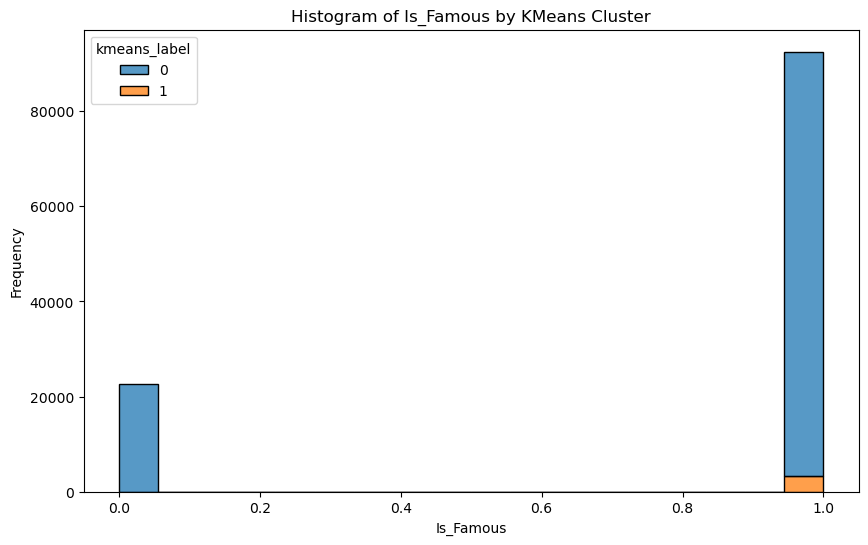

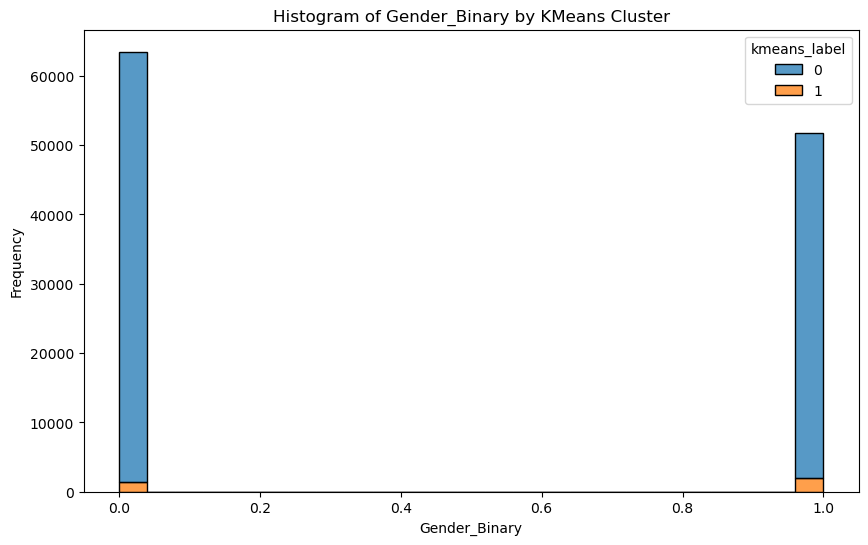

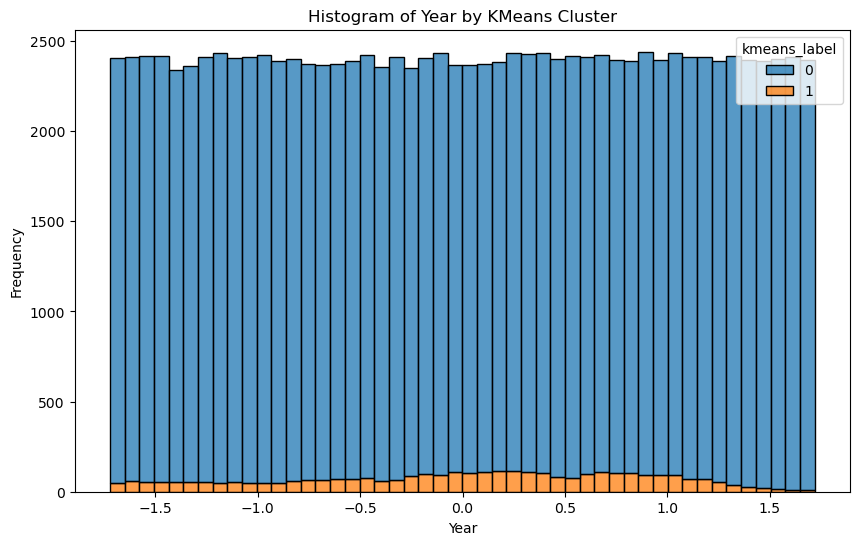

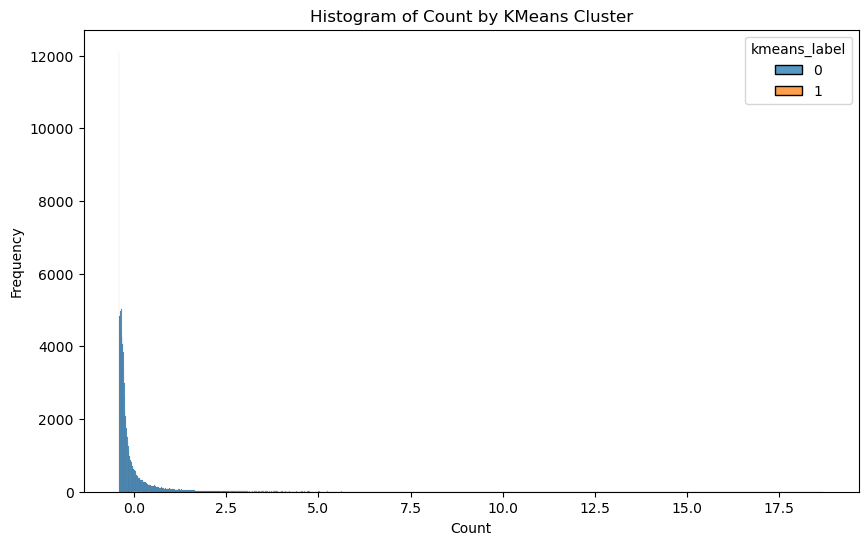

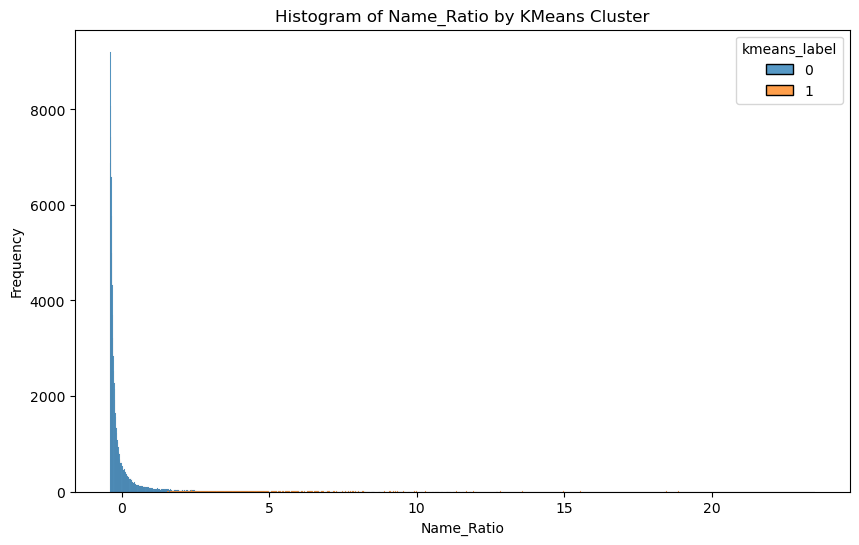

...

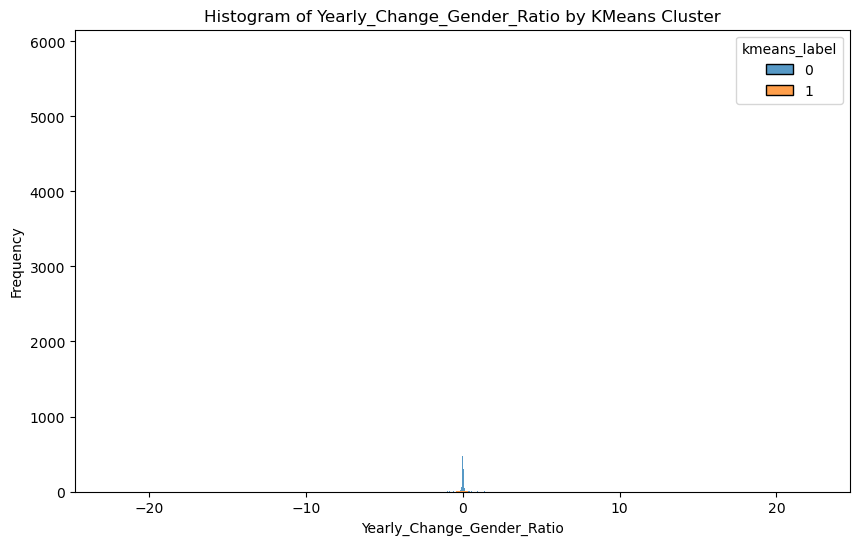

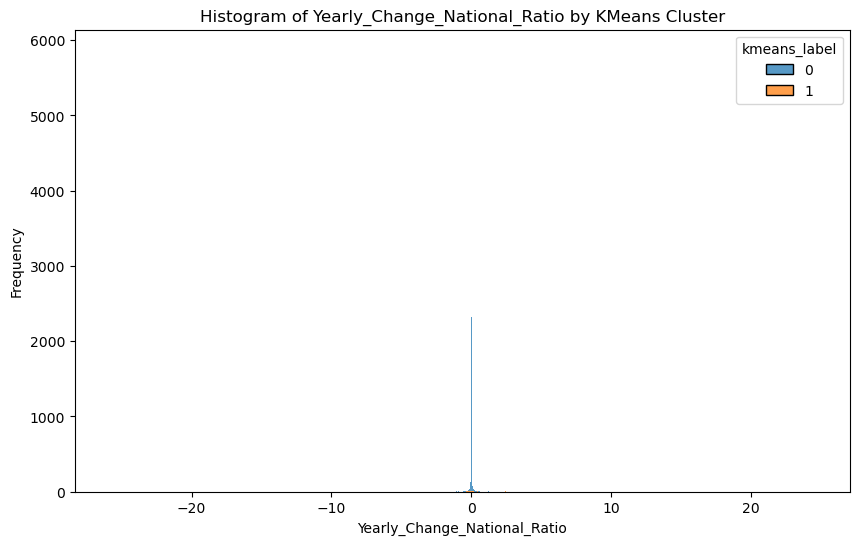

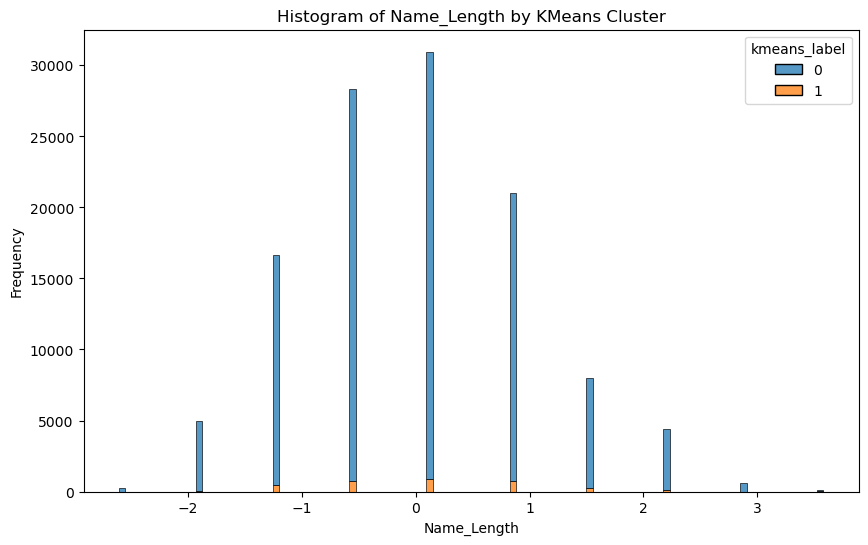

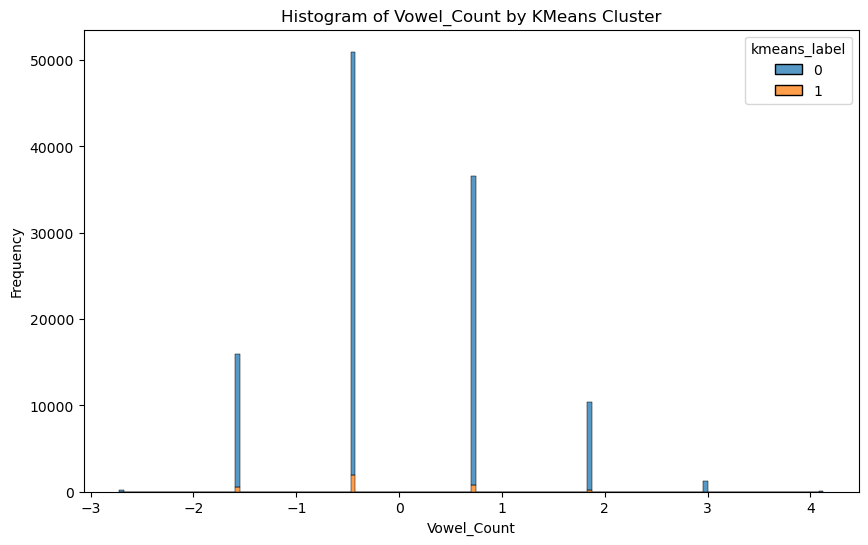

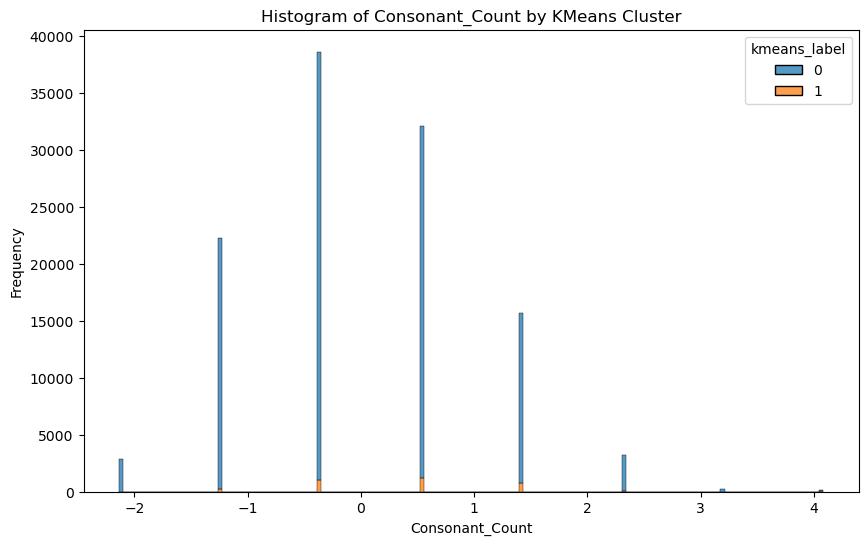

In [19]:

# Plot histograms of features for each cluster
features = df_train_scaled.columns[:-3]  # Excluding cluster labels
for feature in features:
    plt.figure(figsize=(10, 6))
    sns.histplot(data=df_train_scaled, x=feature, hue='kmeans_label', multiple="stack")
    plt.title(f'Histogram of {feature} by KMeans Cluster')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.show()


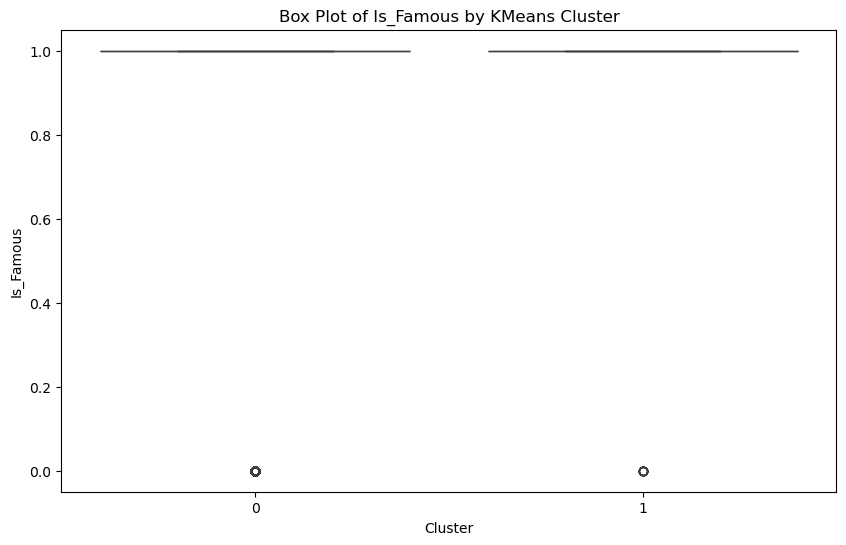

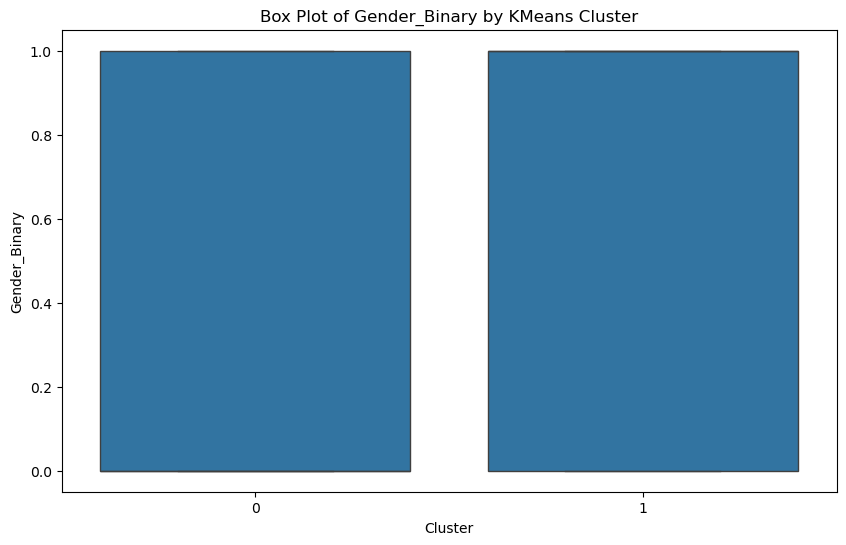

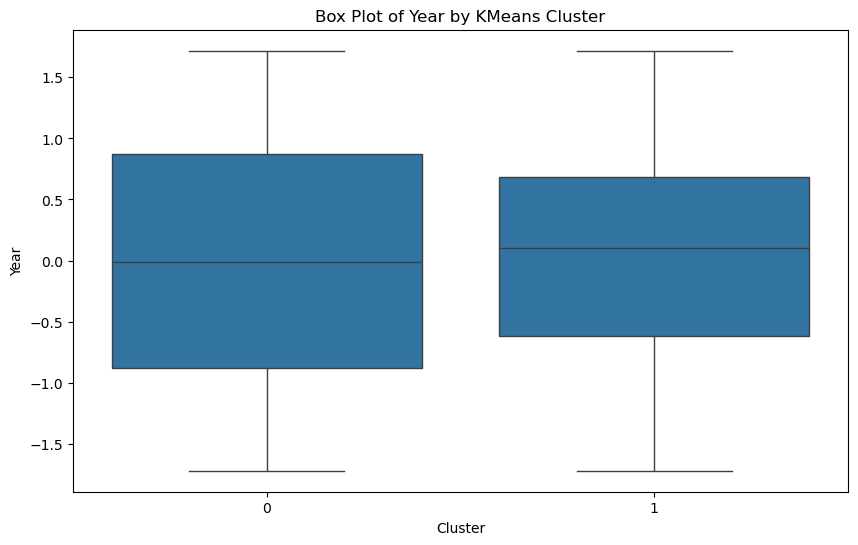

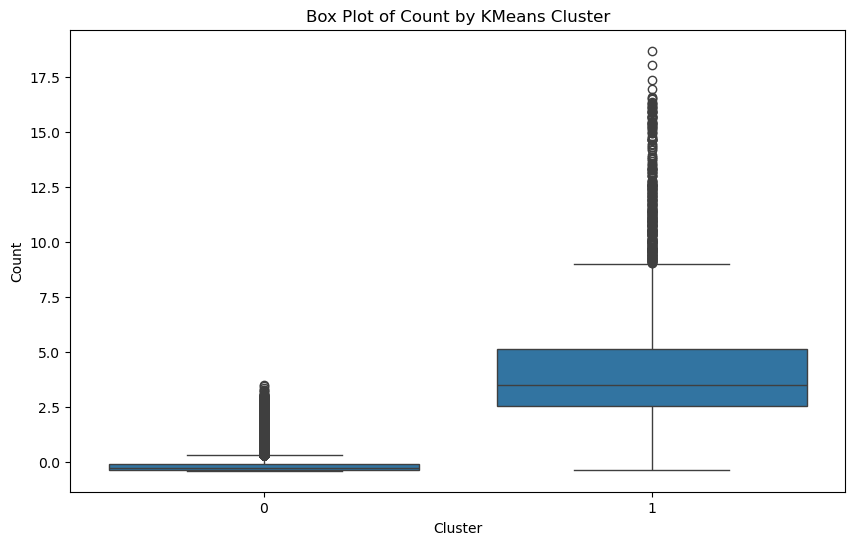

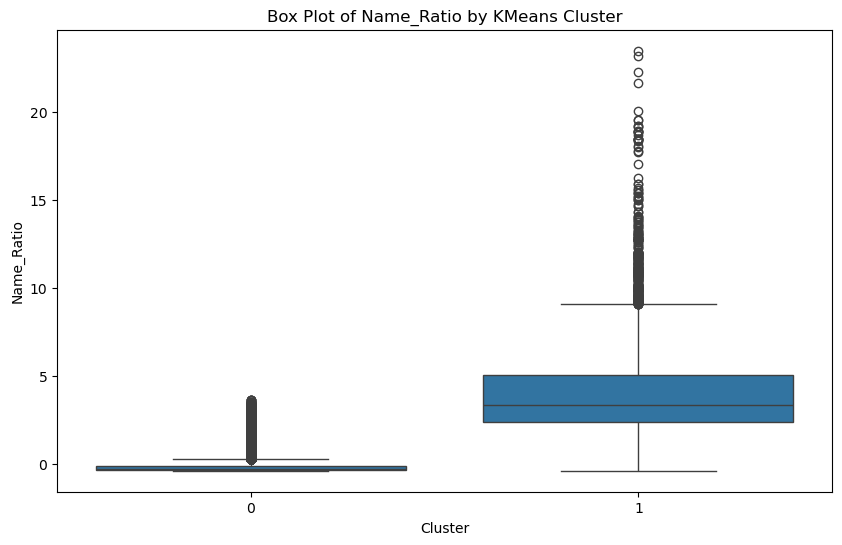

...

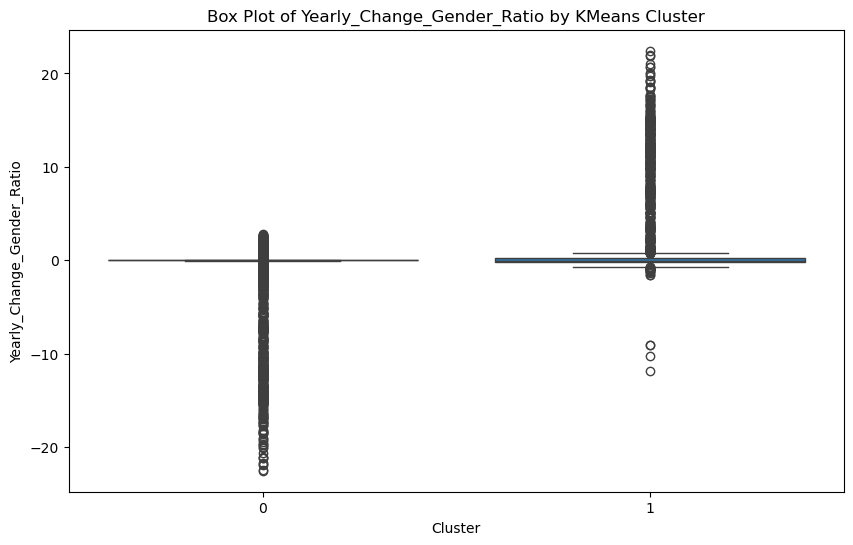

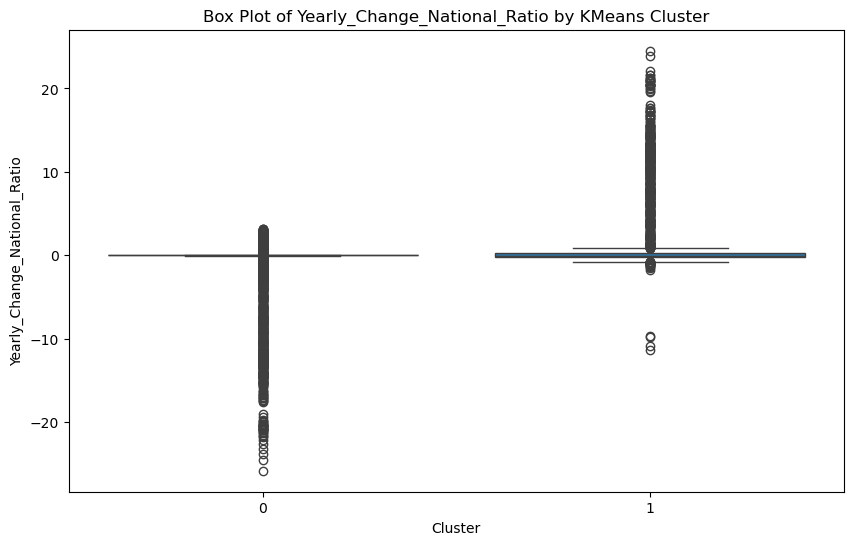

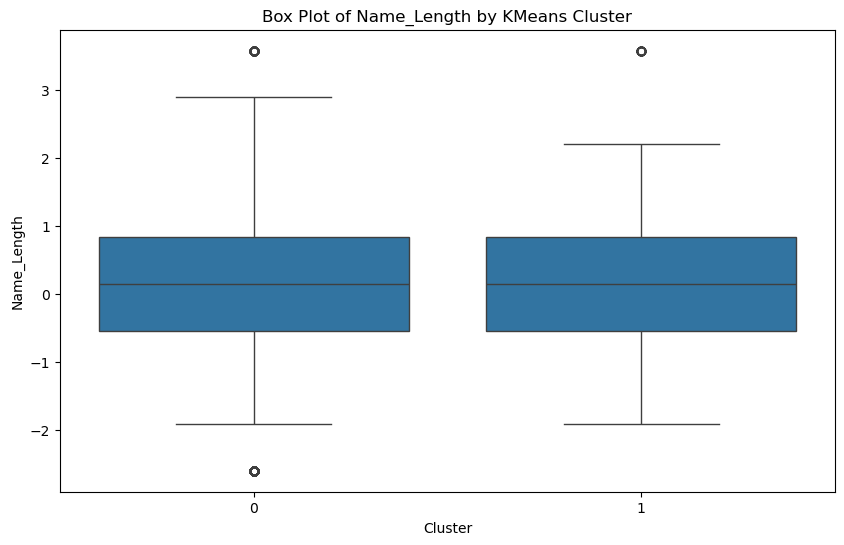

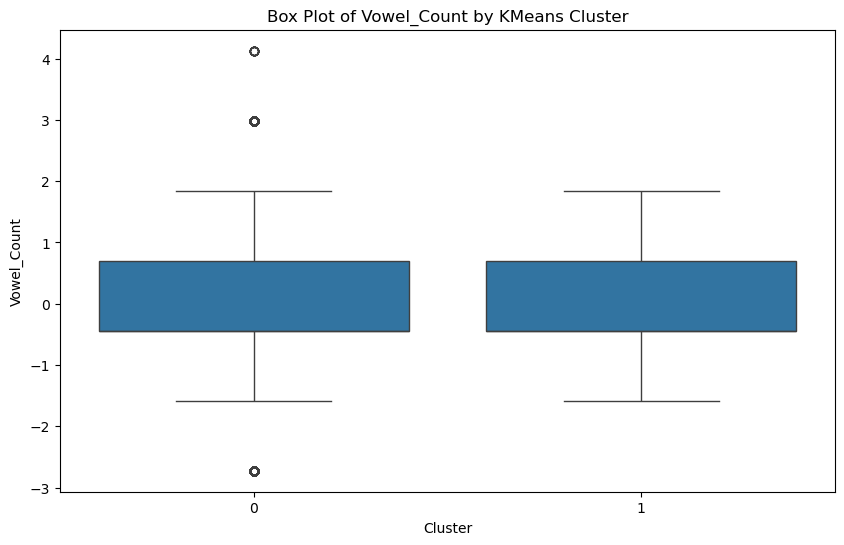

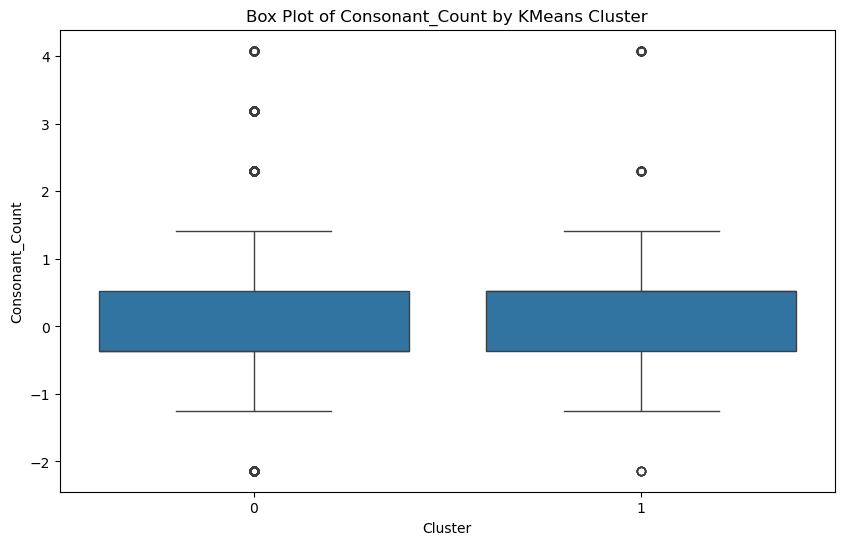

In [20]:
for feature in features:
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=df_train_scaled, x='kmeans_label', y=feature)
    plt.title(f'Box Plot of {feature} by KMeans Cluster')
    plt.xlabel('Cluster')
    plt.ylabel(feature)
    plt.show()


In [21]:
loadingsDF.head(20)

,PC1,PC2,PC3
Year,0.028708,0.030595,-0.008286
Count,0.019732,0.060318,-0.131792
Name_Ratio,0.029253,0.098020,-0.086943
Gender_Name_Ratio,0.380013,0.048165,0.061739
Is_Famous,0.407988,-0.041959,0.051933
Gender_Binary,0.406229,-0.046569,0.040671
Year_of_Last_Appearance,0.106419,0.138897,-0.045830
Rolling_Average_Count_5_Years,0.350664,0.187435,0.135579
Rolling_Average_Gender_Ratio_5_Years,0.377769,0.161357,0.157922
Rolling_Average_National_Ratio_5_Years,0.377797,0.160721,0.166488


In [30]:
loadingsDF.shape

(18, 3)

In [31]:
pca_df.shape

(115233, 4)

In [32]:
pca_df.head(5)

,PC1,PC2,PC3,kmeans_label
0,-0.216822,0.033327,0.019218,0
1,-0.926553,-0.320717,0.116429,0
2,-0.067384,1.040299,-1.821265,0
3,-1.040146,-1.246249,1.806323,0
4,-0.382946,-0.229498,0.497243,0


In [33]:
#add the labels back to the original data!

data_num['kmeans'] = pca_df['kmeans_label']

In [34]:
data_num.isna().sum()

Year                                      0
Count                                     0
Name_Ratio                                0
Gender_Name_Ratio                         0
Is_Famous                                 0
Gender_Binary                             0
Year_of_Last_Appearance                   0
Is_Top_100                                0
Rolling_Average_Count_5_Years             0
Rolling_Average_Gender_Ratio_5_Years      0
Rolling_Average_National_Ratio_5_Years    0
Yearly_Change_Count                       0
Yearly_Change_Gender_Ratio                0
Yearly_Change_National_Ratio              0
Name_Length                               0
Vowel_Count                               0
Consonant_Count                           0
Vowel_Ratio                               0
Ends_With_Specified_Letters               0
kmeans                                    0
dtype: int64

In [35]:
#let's remove the null values so we are working with data that is complete

data_num = data_num.dropna()

<Axes: >

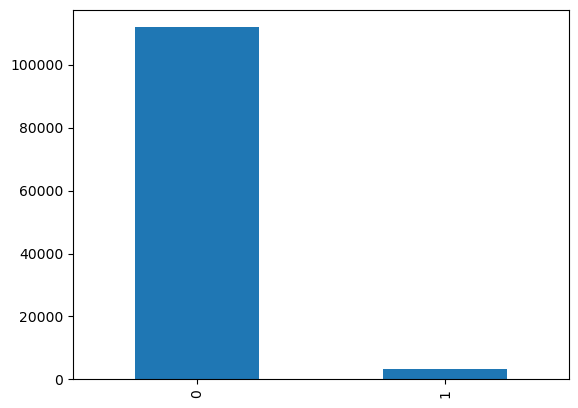

In [36]:
data_num['kmeans'].value_counts().plot(kind='bar')

In [37]:
featureMeans = data_num.groupby('kmeans').mean().T
featureMeans

kmeans,0,1
Year,1937.118401,1936.212266
Count,2052.966105,2107.512653
Name_Ratio,0.913050,0.900113
Gender_Name_Ratio,1.823957,1.789732
Is_Famous,0.817795,0.805299
Gender_Binary,0.441291,0.430188
Year_of_Last_Appearance,1990.205079,1988.929443
Is_Top_100,0.109731,0.101518
Rolling_Average_Count_5_Years,2006.446172,2066.314657
Rolling_Average_Gender_Ratio_5_Years,1.828844,1.804930


In [29]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree

X= data_num.drop(columns=['kmeans'])
y= data_num['kmeans']

DT_model= DecisionTreeClassifier(max_depth=4)
DT_model.fit(X, y)

DecisionTreeClassifier(max_depth=4)

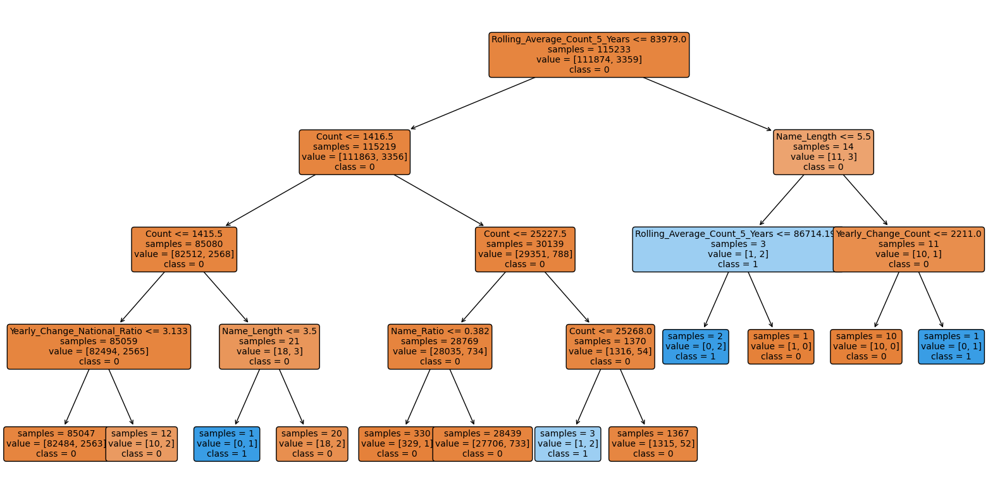

In [30]:
#plot tree

fig, ax = plt.subplots(figsize=(20,10))

plot_tree(DT_model, feature_names = X.columns.to_list(),
          class_names = ['0','1'],
          rounded = True,
          impurity=False,
          ax=ax,
          filled=True,
          fontsize=10);

Rolling_Average_Count_5_Years: This feature is used as the root node, suggesting it plays a critical role in determining the class labels.
Count: Appears multiple times as an important feature for further splitting the data.
Name_Length: Used in multiple branches, suggesting that the length of names has some predictive power for distinguishing between the classes.
Yearly_Change_National_Ratio, Yearly_Change_Count, and Name_Ratio: These features also play a role in further splits, indicating their importance in the classification process.

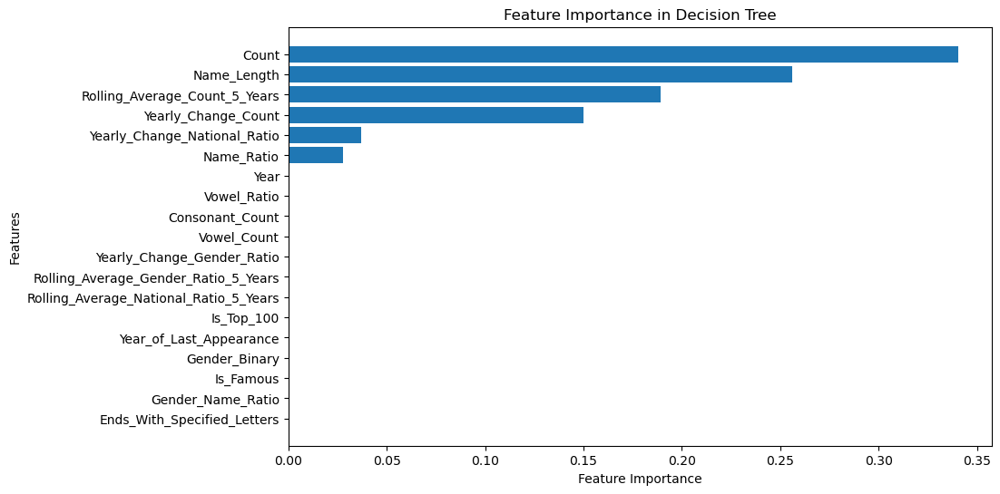

,Feature,Importance
1,Count,0.340450
14,Name_Length,0.255983
8,Rolling_Average_Count_5_Years,0.189015
11,Yearly_Change_Count,0.149864
13,Yearly_Change_National_Ratio,0.036870
2,Name_Ratio,0.027819
0,Year,0.000000
17,Vowel_Ratio,0.000000
16,Consonant_Count,0.000000
15,Vowel_Count,0.000000


In [31]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Assuming your Decision Tree Classifier is stored in DT_model

# Get the feature importance from the trained Decision Tree model
feature_importance = DT_model.feature_importances_

# If you have a list of the feature names
features = X.columns

# Create a DataFrame for better visualization
importance_df = pd.DataFrame({
    'Feature': features,
    'Importance': feature_importance
})

# Sort by importance
importance_df = importance_df.sort_values(by='Importance', ascending=False)

# Plotting the feature importance
plt.figure(figsize=(10, 6))
plt.barh(importance_df['Feature'], importance_df['Importance'])
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance in Decision Tree')
plt.gca().invert_yaxis()
plt.show()

# Display the feature importance DataFrame
importance_df
